# COVID-19 Tweets

## Data extaction and cleaning
I get the covid-19 related tweets from https://ieee-dataport.org/open-access/coronavirus-covid-19-geo-tagged-tweets-dataset. These are coronavirus-related tweets using 54 different keywords that are commonly used while referencing the pandemicIt includes. Complying with Twitter's content redistribution policy, only the tweet IDs are shared. Let's first extract out the tweets id's and save them in ids.

In [3]:
import plotly.graph_objects as go
import pandas as pd
from twarc import Twarc
import googlemaps
import time
import argparse
from google.cloud import language
from google.cloud.language import enums
from google.cloud.language import types
from google.cloud import translate_v2 as translate
import plotly.express as px


import glob
import pandas as pd
ids = []
glued_data = pd.DataFrame()
for file_name in glob.glob('geo_tagged_tweets/'+'*.csv'):
    x = pd.read_csv(file_name)
    ids.extend(x.iloc[:,0])
dates = '2020/3/19 - 2020/7/30'

/usr/local/google/home/danqingwang/.local/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (38,39) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


Next I download the tweets from their ids using Twarc. To do this, one needs a twitter developer account. I use googlemap api to get their state, county information

In [ ]:
def get_pos(coord):
    pos = gmaps.reverse_geocode(coord,location_type="approximate")
    keys = ['country', 'administrative_area_level_1','administrative_area_level_2']
    dic = {}
    if not pos:
        return None, None, None
    if isinstance(pos, list):
        pos = pos[0]
    for address in pos['address_components']:
        for key in keys:
            if key in address['types']:
                dic[key] = address['short_name']
    return [dic[key] if key in dic.keys() else None for key in keys]
gmaps = googlemaps.Client(key = KEY)

t = Twarc(consumer_key, consumer_secret, access_token, access_token_secret)
df = pd.DataFrame(columns = ['created_at', 'id', 'id_str', 'full_text', 'truncated', 'display_text_range', 'entities', 'source', 'in_reply_to_status_id', 'in_reply_to_status_id_str', 'in_reply_to_user_id', 'in_reply_to_user_id_str', 'in_reply_to_screen_name', 'user', 'geo', 'coordinates', 'place', 'contributors', 'retweeted_status', 'is_quote_status', 'retweet_count', 'favorite_count', 'favorited', 'retweeted', 'lang','state','county'])
for tweet in t.hydrate(ids):
    if not tweet or not tweet['coordinates'] or not tweet['coordinates']['coordinates']:
        continue
    coord = tweet['coordinates']['coordinates']
    country, state, county = get_pos((coord[1],coord[0]))
    if country != 'US':
        continue
    tweet['state'] = state
    tweet['county'] = county
    df = df.append(tweet, ignore_index = True)

In [ ]:
from datetime import datetime
def add_date(df):
    for i in range(df.shape[0]):
        df.loc[i,'date'] = datetime. strptime(df.loc[i,'created_at'], '%a %b %d %H:%M:%S %z %Y').date() 
def add_long_lat(df):
    for i in range(df.shape[0]):
        df.loc[i,'long'] = df.loc[i,'coordinates']['coordinates'][0]
        df.loc[i,'lat'] = df.loc[i,'coordinates']['coordinates'][1]    
def add_properties(df):
    add_date(df)
    add_long_lat(df)

## Data visualization
I'm adding bulk sentiment analysis to the tweets and entity sentiment analysis. Both are using Google cloud natural language API.

In [414]:
def analyze(content):
    client = language.LanguageServiceClient()
    document = types.Document(
        content=content,
        type=enums.Document.Type.PLAIN_TEXT)
    annotations = client.analyze_sentiment(document=document)
    time.sleep(0.1)
    return annotations

from google.cloud import language_v1
from google.cloud.language_v1 import enums


def sample_analyze_entity_sentiment(text_content):
    """
    Analyzing Entity Sentiment in a String

    Args:
      text_content The text content to analyze
    """

    client = language_v1.LanguageServiceClient()

    # Available types: PLAIN_TEXT, HTML
    type_ = enums.Document.Type.PLAIN_TEXT

    # Optional. If not specified, the language is automatically detected.
    # For list of supported languages:
    # https://cloud.google.com/natural-language/docs/languages
    language = "en"
    document = {"content": text_content, "type": type_, "language": language}

    # Available values: NONE, UTF8, UTF16, UTF32
    encoding_type = enums.EncodingType.UTF8

    response = client.analyze_entity_sentiment(document, encoding_type=encoding_type)
    time.sleep(0.1)
    return response


In [ ]:
df['sentiment'] = [analyze(x) for x in df['full_text']]  
df['entity_sentiment'] = [sample_analyze_entity_sentiment(x) for x in df['full_text']]    

First plot out distribution of tweets over US. They are more concentrated on the coasts.

In [404]:
fig = go.Figure(data=go.Scattergeo(
        lon = df['long'],
        lat = df['lat'],
        text = df['full_text'],
        mode = 'markers',
        ))

fig.update_layout(
        title = 'Sampled COVID-19 related tweets in US on ' + dates ,
        geo_scope='usa',
    )
fig.show()

Next, visualize the overall-sentiment of these tweets in the us, by coloring the score using sentiment score * magnitude. Overall, it's mostly negative. 

In [ ]:
def add_fips(df):
    df_fips = pd.read_csv('county_fips.csv')
    df_fips
    df.reset_index()
    fips = []
    for i in range(df.shape[0]):
        state, county = df.loc[i,'state'],df.loc[i,'county']
        if not(county):
            fips.append(None)
            continue
        curr = df_fips[df_fips['state_abbr'] == state]
        curr = curr[curr['county_name'].str.contains(county, na=False)]['fips'].values
        if len(curr) > 0:
            s = str(int(curr[0]))
            while len(s) < 5:
                s = '0' + s
            fips.append(s)
        else:
            fips.append(None)
    df['fips'] = fips
def plot_coord(df_full, label):
    df = df_full.dropna(subset=[label])
    fig = go.Figure(data=go.Scattergeo(
            marker_color = df[label],
            lon = df['long'],
            lat = df['lat'],
            text = df['full_text'],
            mode = 'markers',
            marker_colorbar_title=label
            ))

    fig.update_layout(
            title = 'Sampled COVID-19 related tweets in USA on ' + date,
            geo_scope='usa',
            geo = dict(landcolor = "rgb(200, 200, 200)",
            subunitcolor = "rgb(255, 255, 255)",
            countrycolor = "rgb(255, 255, 255)",)
        )
    fig.show()
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

def plot_county(df, label):
    if 'fips' not in df.columns:
        add_fips(df)
    df_tmp = df.groupby('fips').mean()
    fig = px.choropleth(df_tmp, geojson=counties, locations= df_tmp.index, color=label,
                           scope="usa",
                          )
    fig.update_layout(
        title = label.replace('_', " ") + ' of sampled COVID-19 related tweets in USA on ' + date,
           )
    fig.show()
def plot_state(df, label):
    df_tmp = df.groupby('state').mean()
    fig = px.choropleth(df_tmp, locations = df_tmp.index, locationmode = 'USA-states',color = df_tmp[label], scope = 'usa')
    fig.update_layout(
            title = label.replace('_', " ") + ' of sampled COVID-19 related tweets in USA on ' + date,
            )
    fig.show()
def plot_all(df, label):
    plot_coord(df, label)
    plot_county(df, label)
    plot_state(df, label)
plot_all(df, 'sentiment_score')

In [ ]:
def add_score(df, keys):
    tmp = []
    for response in df['entity_sentiment']:
        curr = []
        for entity in response.entities:
            name = entity.name.lower()
            if not name in keys:
                continue
            sentiment = entity.sentiment
            curr.append(sentiment.magnitude * sentiment.score)
        if len(curr):
            tmp.append(sum(curr)/len(curr))
        else:
            tmp.append(None)
    df['sentiment on ' + keys[0]] = tmp
    plot_all(df, 'sentiment on ' + keys[0])
add_score(df,['mask','masks','face masks','facemask','facemask','maskup'])

To see what are the entities mentioned and sentiment on these entities. First, see what are the mostly mentioned enities. Also need a more systemtic way to make same items the same.

In [ ]:
dic = {}
covid_set = (['#coronavirus','covid-19','coronavirus','corona','covid'])
quarantine = []
for response in df['entity_sentiment']:
    for entity in response.entities:
        name = entity.name.lower()
        if name in covid_set:
            name = 'covid19'
        if name[0] == '#':
            name = name[1:]
        sentiment = entity.sentiment
        if name in dic:
            dic[name].append(sentiment.magnitude * sentiment.score)
        else:
            dic[name] = [sentiment.magnitude * sentiment.score]
        if name == 'quarantine':
            quarantine.append(entity)
inverse = [(len(value), key) for key, value in dic.items()]
inverse.sort(reverse = True)
inverse

In [ ]:
import spacy
from spacy.lang.en import English
from bs4 import BeautifulSoup
import string
import re
parser = English()
def remove_html(text):
    soup = BeautifulSoup(text, 'lxml')
    text = soup.get_text()
    text = re.sub(r'https?:\/\/(www\.)?[-a-zA-Z0-9@:%._\+~#=\/]{2,256}', '', text, flags=re.MULTILINE)
    return text
def remove_punctuations(text):
    ans = ""
    for c in text:
        if c not in string.punctuation + '‼':
            ans += c
    return ans
def tokenize(text):
    lda_tokens = []
    tokens = parser(text)
    for token in tokens:
        if token.orth_.isspace():
            continue
        elif token.like_url:
            lda_tokens.append('URL')
        elif token.orth_.startswith('@'):
            lda_tokens.append('SCREEN_NAME')
        else:
            lda_tokens.append(token.lower_)
    return lda_tokens
import nltk
#nltk.download('wordnet')
from nltk.corpus import wordnet as wn
def get_lemma(word):
    lemma = wn.morphy(word)
    if lemma is None:
        return word
    else:
        return lemma
    
from nltk.stem.wordnet import WordNetLemmatizer
def get_lemma2(word):
    return WordNetLemmatizer().lemmatize(word)
#nltk.download('stopwords')
en_stop = set(nltk.corpus.stopwords.words('english'))
def prepare_text_for_lda(text):
    text = remove_html(text)
    text = remove_punctuations(text)
    tokens = tokenize(text)
    tokens = [token for token in tokens if len(token) > 4]
    tokens = [token for token in tokens if token not in en_stop]
    tokens = [get_lemma(token) for token in tokens]
    return tokens
import random
text_data = []
for line in df['full_text']:
    tokens = prepare_text_for_lda(line)
    text_data.append(tokens)
df['tokens'] = text_data

In [ ]:
full_tokens = []
for c in df['tokens']:
    full_tokens.extend(c)

In [ ]:
bigrams = []
for tokens in df['tokens']:
    for i in range(len(tokens) - 2):
        bigrams.append((tokens[i], tokens[i + 1], tokens[i + 2]))

In [ ]:
from collections import Counter
print(Counter(bigrams))

In [373]:
import nltk
import string
import re
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import WordCloud, STOPWORDS
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
def generate_word_map(text, place, num, date1, date2):
    WNL = nltk.WordNetLemmatizer()
    # Lowercase and tokenize
    text = text.lower()
    # Remove single quote early since it causes problems with the tokenizer.
    text = text.replace("'", "")
    # Remove numbers from text
    remove_digits = str.maketrans('', '', string.digits)
    text = text.translate(remove_digits)
    # Remove html
    soup = BeautifulSoup(text, 'lxml')
    text = soup.get_text()
    text = re.sub(r'https?:\/\/(www\.)?[-a-zA-Z0-9@:%._\+~#=\/]{2,256}', '', text, flags=re.MULTILINE)
    tokens = nltk.word_tokenize(text)
    text1 = nltk.Text(tokens)

    # Remove extra chars and remove stop words.
    text_content = [''.join(re.split("[ .,;:!?‘’``'''‼@#$%^_&*()<>{}~\n\t\\\-]", word)) for word in text1]

    #set the stopwords list
    stopwords_wc = set(STOPWORDS)
    text_content = [word for word in text_content if word not in stopwords_wc]

    # After the punctuation above is removed it still leaves empty entries in the list.
    text_content = [s for s in text_content if len(s) != 0]

    # Best to get the lemmas of each word to reduce the number of similar words
    text_content = [WNL.lemmatize(t) for t in text_content]

    nltk_tokens = nltk.word_tokenize(text)  
    bigrams_list = list(nltk.bigrams(text_content))
    dictionary2 = [' '.join(tup) for tup in bigrams_list]

    #Using count vectoriser to view the frequency of bigrams
    vectorizer = CountVectorizer(ngram_range=(2, 2))
    bag_of_words = vectorizer.fit_transform(dictionary2)
    vectorizer.vocabulary_
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    
    print(str(num) + ' tweets in ' + place)
    #Generating wordcloud and saving as jpg image
    words_dict = dict(words_freq)
    WC_height = 1000
    WC_width = 1500
    WC_max_words = 200
    wordCloud = WordCloud(max_words=WC_max_words, height=WC_height, width=WC_width,stopwords=stopwords_wc)
    wordCloud.generate_from_frequencies(words_dict)
    plt.title('Bigrams in ' + place + ' from ' + date1.strftime("%m/%d/%y")+' to '+date2.strftime("%m/%d/%y"))
    plt.imshow(wordCloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    wordCloud.to_file('wordcloud_bigram.jpg')
    return words_freq

In [402]:
import plotly.express as px
def plot_bar(words_freq,place, num, date1, date2):
    df_word = pd.DataFrame()
    for i in range(len(words_freq)):
        a,b = words_freq[i]
        df_word.loc[i,'Bigram'] = a
        df_word.loc[i,'Frequency'] = b
    fig = px.bar(df_word, x="Bigram", y="Frequency", 
                 title = 'Top 10 Birgrams in ' + place + ' from ' + date1.strftime("%m/%d/%y")+' to '+date2.strftime("%m/%d/%y"))
    fig.show()
def plot_map(place, level, date1, date2):
    s = ""
    num = 0
    for i in range(df.shape[0]):
        if df.loc[i,level] == place and df.loc[i,'date'] >=date1 and df.loc[i,'date']<date2:
            s += df.loc[i,'full_text']
            num += 1
    words_freq = generate_word_map(s, place, num, date1, date2)
    plot_bar(words_freq[:10],place, num, date1, date2)
    #plot_trend(words_freq,place,level,date1,date2)
    return words_freq
def plot_place(dates, places):
    for x,y in dates:
        for place in places:
            if len(place) == 2:
                level = 'state'
            else:
                level = 'county'
            plot_map(place, level, x, y)

In [ ]:
date1 = datetime(2020, 5, 20, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 5, 30, 0, 00,tzinfo=pytz.UTC).date()
plot_place([(date1, date2)],['Alameda County','Santa Clara County'])

In [ ]:
date1 = datetime(2020, 5, 15, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 5, 25, 0, 00,tzinfo=pytz.UTC).date()
plot_date(date1, date2)

In [ ]:
date1 = datetime(2020, 4, 20, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 4, 30, 0, 00,tzinfo=pytz.UTC).date()
plot_date(date1, date2)

In [ ]:
date1 = datetime(2020, 5, 20, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 5, 30, 0, 00,tzinfo=pytz.UTC).date()
plot_date(date1, date2)

In [ ]:
date1 = datetime(2020, 6, 20, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 6, 30, 0, 00,tzinfo=pytz.UTC).date()
plot_date(date1, date2)

In [ ]:
date1 = datetime(2020, 7, 20, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 7, 30, 0, 00,tzinfo=pytz.UTC).date()
plot_date(date1, date2)

In [ ]:
date1 = datetime(2020, 3, 19, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 7, 30, 0, 00,tzinfo=pytz.UTC).date()
plot_date(date1, date2)

In [411]:
from datetime import datetime, timedelta
ans = 0
x = []
y = []
for i in range(1000):
    date = date1 + timedelta(days=i)
    if date > date2:
        break
    x.append(date)
    y.append(len(df[df.date == date]))
fig = px.line(x=x, y=y)
fig.update_layoudft(title='Number of geo-tagged tweets in US',xaxis_title="Date",
    yaxis_title="Count")


fig.show()

In [232]:
from datetime import datetime, timedelta
ans = 0
x = []
y = []
for i in range(1000):
    date = date1 + timedelta(days=i)
    if date > date2:
        break
    x.append(date)
    y.append(len(df[df.date == date]))
fig = px.line(x=x, y=y)
fig.update_layout(title='Number of geo-tagged tweets in US',xaxis_title="Date",
    yaxis_title="Count")


fig.show()

69660

In [220]:
len(df)

69779

In [350]:
import nltk
import string
import re
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import WordCloud, STOPWORDS
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
def bigrams_exist(text, bigrams):
    WNL = nltk.WordNetLemmatizer()
    # Lowercase and tokenize
    text = text.lower()
    # Remove single quote early since it causes problems with the tokenizer.
    text = text.replace("'", "")
    # Remove numbers from text
    remove_digits = str.maketrans('', '', string.digits)
    text = text.translate(remove_digits)
    # Remove html
    soup = BeautifulSoup(text, 'lxml')
    text = soup.get_text()
    text = re.sub(r'https?:\/\/(www\.)?[-a-zA-Z0-9@:%._\+~#=\/]{2,256}', '', text, flags=re.MULTILINE)
    tokens = nltk.word_tokenize(text)
    text1 = nltk.Text(tokens)

    # Remove extra chars and remove stop words.
    text_content = [''.join(re.split("[ .,;:!?‘’``'''‼@#$%^_&*()<>{}~\n\t\\\-]", word)) for word in text1]

    #set the stopwords list
    stopwords_wc = set(STOPWORDS)
    text_content = [word for word in text_content if word not in stopwords_wc]

    # After the punctuation above is removed it still leaves empty entries in the list.
    text_content = [s for s in text_content if len(s) != 0]

    # Best to get the lemmas of each word to reduce the number of similar words
    text_content = [WNL.lemmatize(t) for t in text_content]

    nltk_tokens = nltk.word_tokenize(text)  
    bigrams_list = list(nltk.bigrams(text_content))
    dictionary2 = [' '.join(tup) for tup in bigrams_list]
    vectorizer = CountVectorizer(ngram_range=(2, 2))

    bag_of_words = vectorizer.fit_transform(dictionary2)
    vectorizer.vocabulary_
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    ans = [0 for _ in range(len(bigrams))]
    for a,b in words_freq:
        for i in range(len(bigrams)):
            if a == bigrams[i]:
                ans[i] = b  
    return ans

13694 tweets in CA


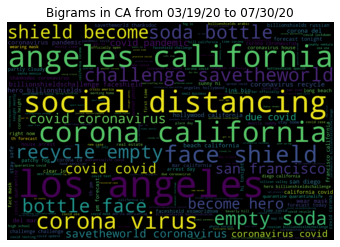

In [403]:
date1 = datetime(2020, 3, 19, 0, 00,tzinfo=pytz.UTC).date()
date2 = datetime(2020, 7, 30, 0, 00,tzinfo=pytz.UTC).date()
def plot_trend(words_freq,place,level,date1,date2):
    #print(words_freq)
    bigrams = []
    for i in range(5):
        bigrams.append(words_freq[i][0])
    x = []
    y = [[] for _ in range(len(bigrams))]
    for i in range(abs((date2 - date1).days) + 1):
        date = date1 + timedelta(days = i)
        s = ""
        for t in df[(df[level] == place) & (df.date == date)]['full_text'].values:
            s += t
        curr = bigrams_exist(s, bigrams)
        for i in range(len(bigrams)):
            y[i].append(curr[i])
        x.append(date)
    return x, y, bigrams
words  = plot_map('CA', 'state', date1, date2)
x, y, bigrams = plot_trend(words, 'CA', 'state',date1,date2)

In [397]:
import plotly.graph_objects as go
import numpy as np

x = np.array(x)

fig = go.Figure()
for i in range(len(y)):
    fig.add_trace(go.Scatter(x=x, y=y[i], name = bigrams[i]))

fig.update_layout(legend=dict(y=0.5, font_size=16),title = 'Top 5 Bigrams time series in CA',
                 xaxis_title="Date",
    yaxis_title="Count")

fig.show()

In [380]:
bigrams

[922, 564, 552, 492, 315]

In [400]:
def plot_all(date1, date2):
    s = ""
    num = 0
    for i in range(df.shape[0]):
        if df.loc[i,'date'] >=date1 and df.loc[i,'date']<date2:
            s += df.loc[i,'full_text']
            num += 1
    words_freq = generate_word_map(s, 'US', num, date1, date2)
    bigrams = []
    for i in range(5):
        bigrams.append(words_freq[i][0])
    x = []
    y = [[] for _ in range(len(bigrams))]
    for i in range(abs((date2 - date1).days) + 1):
        date = date1 + timedelta(days = i)
        s = ""
        for t in df[df.date == date]['full_text'].values:
            s += t
        curr = bigrams_exist(s, bigrams)
        for i in range(len(bigrams)):
            y[i].append(curr[i])
        x.append(date)
    x = np.array(x)
    fig = go.Figure()
    for i in range(len(y)):
        fig.add_trace(go.Scatter(x=x, y=y[i], name = bigrams[i]))

    fig.update_layout(legend=dict(y=0.5,font_size=16), title = 'Top 5 Bigrams time series in US',
                                 xaxis_title="Date",yaxis_title="Count")

    fig.show()
    

69120 tweets in US


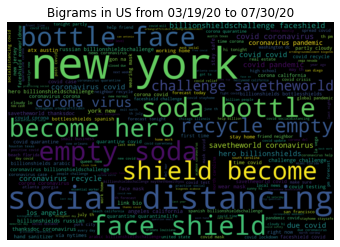

In [401]:
plot_all(date1, date2)